# __Programming Project 201799487 - GEOG5990M__

### __Introduction:__

Food insecurity has become an alarming isuue in today's world. Political discussions around food insecurity have persisted in the context of the UK's economic downturn and welfare reform. Food has a significant part in shaping people's identities, yet the sharp increase in food banks and food donation locations in stores and educational institutions speaks to the normalisation of food assistance. Furthermore, it is projected that three million people in the UK are at danger of malnutrition (Purdam, 2016).

In this project we are going to find the association between two variable to know if there a strong, moderate or light relation exist among them. 

### __Research Question:__
Are neighbourhoods in Sheffield with better __socio demographic__ rates have more access to __supermarket retail facilities__?

### __The two main datasets used in this project are specified below:__

### __Data Source:__

##### __<font color=red>1. Data Name:</font>__ __Priority Places for Food Index Version 2__

##### __<font color=red>Source:</font>__ CDRC (Consumer Data Research Centre)

##### __<font color=red>Data License:</font>__ UK Open Government License (OGL)



##### __<font color=red>2. Data Name:</font>__ __Lower Layer Super Output Areas (December 2021) Boundaries EW BFE V9__

##### __<font color=red>Source:</font>__ ONS Geography, Office for National Statistics

##### __<font color=red>Data License:</font>__ Open Government Licence v.3.0


Now we will start will importing the required packages for the programming: 

### __1. Data Loading:__

Before loading the data we need to set up the environment. We will import the required

In [1]:
# import required packages 
import geopandas as gpd
import pandas as pd
import seaborn as sns
from scipy import stats
import numpy as np

import matplotlib.pyplot as plt

# import the required machine learning packages
from sklearn import cluster
from sklearn.preprocessing import scale

# set seaborn plotting theme to white
sns.set_theme(style="white")

In [2]:
# import warnings to filter bugs and responding to warnings effectively
import warnings
warnings.filterwarnings('ignore')

In [3]:
# using the PPFI (Priority Places for Food Index) dataset which has been downloaded from CDRC website, we are going to load the csv file of that dataset
# for our convinience we have termed the dataset as 'food' below
# when loading data please change the file_path with the actual file_path uploaded in the GitHub Repository added files

PPFI = pd.read_csv('/Users/pritomborah/Documents/Programming_Project_201799487/ppfi_index_v2_nov2023 (2).csv')
PPFI.head()



,lsoa21cd,domain_supermarket_proximity,domain_supermarket_accessibility,domain_ecommerce_access,domain_socio_demographic,domain_nonsupermarket_proximity,domain_food_for_families,domain_fuel_poverty,country,country_denominator,combined,pp_dec_domain_supermarket_proximity,pp_dec_domain_supermarket_accessibility,pp_dec_domain_ecommerce_access,pp_dec_domain_socio_demographic,pp_dec_domain_nonsupermarket_proximity,pp_dec_domain_food_for_families,pp_dec_domain_fuel_poverty,pp_dec_combined
0,95AA01S1,480,NaN,NaN,810,518,760,NaN,NI,890,810,6,NaN,NaN,10,6,9,NaN,10
1,95AA01S2,446,NaN,NaN,789,511,793,NaN,NI,890,807,6,NaN,NaN,9,6,9,NaN,10
2,95AA01S3,435,NaN,NaN,688,291,686,NaN,NI,890,549,5,NaN,NaN,8,4,8,NaN,7
3,95AA02W1,714,NaN,NaN,470,661,237,NaN,NI,890,454,9,NaN,NaN,6,8,3,NaN,6
4,95AA03W1,344,NaN,NaN,218,467,614,NaN,NI,890,242,4,NaN,NaN,3,6,7,NaN,3


### __2. Data Cleaning:__

The Priority Places for Food Index Version 2 Dataset contains information about the four countries of United Kingdom but since our area of interest is Sheffield which is in England so we will be clearing out the data of Northern Ireland (NI), Scotland (S) and Wales (W).

In [4]:
# Drop rows where any column contains the value 'NI', 'S', 'W'

PPFI2 = PPFI[~PPFI['country'].isin(['NI', 'S', 'W'])]
print("\nDataFrame after dropping rows containing 'NI', 'S' or 'W':")
print(PPFI2)



DataFrame after dropping rows containing 'NI', 'S' or 'W':
        lsoa21cd  domain_supermarket_proximity  \
890    E01000001                         33326   
891    E01000002                         33499   
892    E01000003                         33575   
893    E01000005                         29836   
894    E01000006                         29669   
...          ...                           ...   
34640  E01035758                         29848   
34641  E01035759                          5492   
34642  E01035760                         22790   
34643  E01035761                         11366   
34644  E01035762                          1115   

       domain_supermarket_accessibility  domain_ecommerce_access  \
890                             30025.0                  31936.0   
891                             29729.0                  32952.0   
892                             30082.0                  22662.0   
893                             33271.0                  29841.0   

In [5]:
#The code below shows only the values which contains the information about LSOAs of England.

PPFI2.head()

,lsoa21cd,domain_supermarket_proximity,domain_supermarket_accessibility,domain_ecommerce_access,domain_socio_demographic,domain_nonsupermarket_proximity,domain_food_for_families,domain_fuel_poverty,country,country_denominator,combined,pp_dec_domain_supermarket_proximity,pp_dec_domain_supermarket_accessibility,pp_dec_domain_ecommerce_access,pp_dec_domain_socio_demographic,pp_dec_domain_nonsupermarket_proximity,pp_dec_domain_food_for_families,pp_dec_domain_fuel_poverty,pp_dec_combined
890,E01000001,33326,30025.0,31936.0,23004,32945,10547,30119.0,E,33755,33687,10,9.0,10.0,7,10,4,9.0,10
891,E01000002,33499,29729.0,32952.0,10537,33081,9504,31612.0,E,33755,33710,10,9.0,10.0,4,10,3,10.0,10
892,E01000003,33575,30082.0,22662.0,1821,33662,9129,28226.0,E,33755,33104,10,9.0,7.0,1,10,3,9.0,10
893,E01000005,29836,33271.0,29841.0,399,33134,9685,19575.0,E,33755,32139,9,10.0,9.0,1,10,3,6.0,10
894,E01000006,29669,18191.0,22662.0,11097,25764,17690,5701.0,E,33755,16148,9,6.0,7.0,4,8,6,2.0,5


The above cleaning process removed every rows that contained the word 'NI' which meant Northern Ireland, 'S' for Scotland and 'W' for Wales. This way we had specified the LSOAs of England only and the other rows have been dropped.

In [6]:
#Now we are going to look if there is any Null values in the data
#for that we need to employ "isnull()" function

PPFI2.isnull()

,lsoa21cd,domain_supermarket_proximity,domain_supermarket_accessibility,domain_ecommerce_access,domain_socio_demographic,domain_nonsupermarket_proximity,domain_food_for_families,domain_fuel_poverty,country,country_denominator,combined,pp_dec_domain_supermarket_proximity,pp_dec_domain_supermarket_accessibility,pp_dec_domain_ecommerce_access,pp_dec_domain_socio_demographic,pp_dec_domain_nonsupermarket_proximity,pp_dec_domain_food_for_families,pp_dec_domain_fuel_poverty,pp_dec_combined
890,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
891,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
892,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
893,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
894,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34640,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
34641,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
34642,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
34643,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


The above code does not satisfy our question which is to find if there is any Null values in the dataset. We can lookover the dataset above to find all the values showing as 'False' instead of any 'True' value outputs. It means that we don't have any Null values in the dataset now.

All the relevant data in this dataset that we need for the study is already rounded rumbers so we do not need to perform that function here.

##### __<font color=orange>The above code has been extracted from ChatGPT__

_picture evidence in the form of screenshots are available in the GitHub screenshot folder_

#### __Now we are going to read in the LSOA shapefile for Sheffield:__

In [7]:
#Please use the file path name available from the original file in GitHu.

shp =gpd.read_file('/Users/pritomborah/Documents/Programming_Project_201799487/Lower_layer_Super_Output_Areas_2021_EW_BFE_V9_-3647710721716634062.geojson')
sheffield_shp =shp.loc[shp['LSOA21NM'].str.contains('Sheffield'),:]	
sheffield_shp.to_file('Sheffield.geojson')

In [8]:
sheffield_shp.explore()

#### __Joining the PPFI data to the spatial dataframe of Sheffield:__

In [9]:
# join the PPFI data to the sheffield_shp geodataframe using a lefthand join, on the common ID 'LSOA21CD'/'lsoa21cd'
sheffield_PPFI =sheffield_shp.merge(PPFI2, how='left',left_on='LSOA21CD',right_on='lsoa21cd')


In [10]:
sheffield_PPFI.columns

Index(['FID', 'LSOA21CD', 'LSOA21NM', 'BNG_E', 'BNG_N', 'LONG', 'LAT',
       'GlobalID', 'geometry', 'lsoa21cd', 'domain_supermarket_proximity',
       'domain_supermarket_accessibility', 'domain_ecommerce_access',
       'domain_socio_demographic', 'domain_nonsupermarket_proximity',
       'domain_food_for_families', 'domain_fuel_poverty', 'country',
       'country_denominator', 'combined',
       'pp_dec_domain_supermarket_proximity',
       'pp_dec_domain_supermarket_accessibility',
       'pp_dec_domain_ecommerce_access', 'pp_dec_domain_socio_demographic',
       'pp_dec_domain_nonsupermarket_proximity',
       'pp_dec_domain_food_for_families', 'pp_dec_domain_fuel_poverty',
       'pp_dec_combined'],
      dtype='object')

In [11]:
# map to check it has worked

# look at where is higher risk of Food Insecurity, don't forget smaller numbers = 'higher priority' 
sheffield_PPFI.explore('pp_dec_combined', cmap='Oranges')

## __3. Data  Visualisation:__
#### __Spatial Visualisation:__

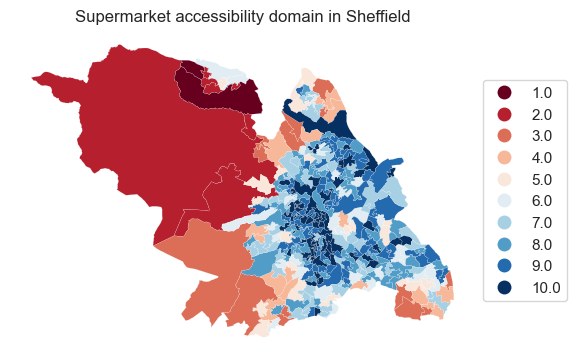

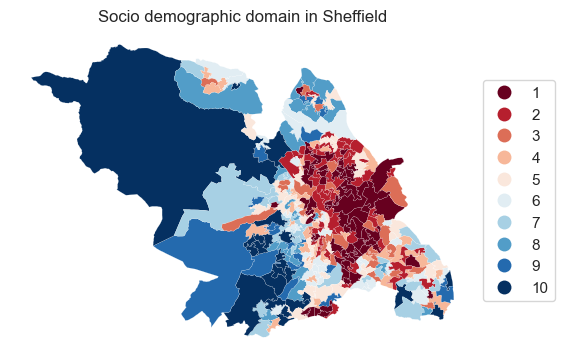

In [12]:

# creating a list of the columns we want to plot
decile_cols =['pp_dec_domain_supermarket_accessibility','pp_dec_domain_socio_demographic']

# create a for loop for plotting a map of each domain 
# this saves writing out 7 blocks of code for each visualisation

# for each item in a range from 0 to 7 (number of items in the deciles_cols list)
for i in range (0, len(decile_cols)):
    
    # produce a plot
    fig, ax = plt.subplots(1, 1, figsize=(6, 6))
    
    # get the ith item in the decile column list and plot
    sheffield_PPFI.plot(column=decile_cols[i],
    
  
    #### format the plot ###
                    
    # reduce linewidth between polygons
    linewidth =0.1,                
    # specify data is categorical (ordinal)                
    categorical=True,                 
    # show the legend
    legend=True, 
    # define the legend palette
    cmap='RdBu', 
    # use the define axis                
    ax=ax,
    # position the legend         
    legend_kwds={'loc': 'center left','bbox_to_anchor':(1,0.5)})
    
    # add a title based on the column plotted, formatting the title to look better
    plt.title(decile_cols[i].replace('_',' ').replace('pp dec domain ','').capitalize()+' domain in Sheffield')
    
    # do not plot with the axis showing
    plt.axis('off')
    # save the figure as an image with name reflecting the domain plotted
    plt.savefig(str(decile_cols[i])+'_'+'Sheffield'+'.jpg',bbox_inches='tight');

#### __Here, it is also worth mentioning that the colours combination of <font color=red>Red</font> and <font color=blue>Blue</font> are the safest and most effective for visualisation and especially the blue colour can be seen by colourblind individuals as well.__

### __We can also show the association between the two variable with the help of a scatter plot:__

#### __Non-Spatial Visualisation:__

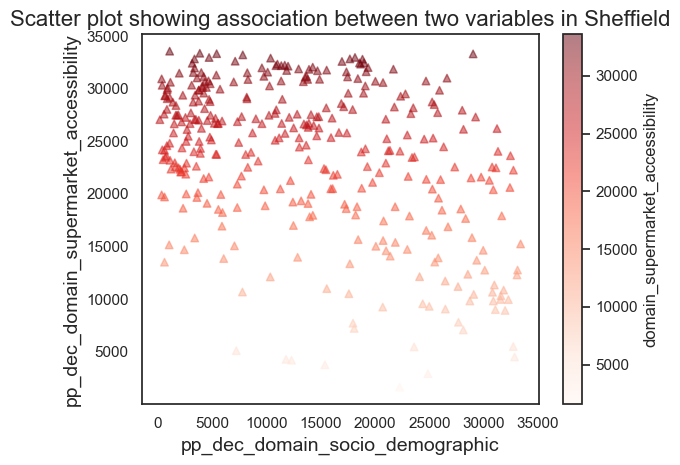

In [13]:
#Scatter plot employed to show association between two variables.

sheffield_PPFI.plot.scatter(x='domain_socio_demographic', y='domain_supermarket_accessibility', marker='^', c='domain_supermarket_accessibility', cmap='Reds', s=30, alpha=0.5);

plt.title('Scatter plot showing association between two variables in Sheffield', fontsize=16)
plt.xlabel('pp_dec_domain_socio_demographic', fontsize=14)
plt.ylabel('pp_dec_domain_supermarket_accessibility', fontsize=14)
plt.show()


#### __Discussion on the outcome of the scatterplot:__

From the above scatter plot we can see that it is not showing a very strong association between two variable in axis x= (domain_socio_demographic) and axis y= (domain_supermarket_accessibility). The intensity of clustered plots are seen to be towards the top left end corner where the brightness of the plots are highest. The brightness of the plots fades towards the lower value. Here, it can be said that the value in x axis is proportional to the value of y axis. This proves that there is a positive association between the two variable and we can define that better socio demographic conditions of people let them enjoy better supermartket accessibility.

#### __Another way of showing the Non-Spatial Visualisation would be to create pair plot:__

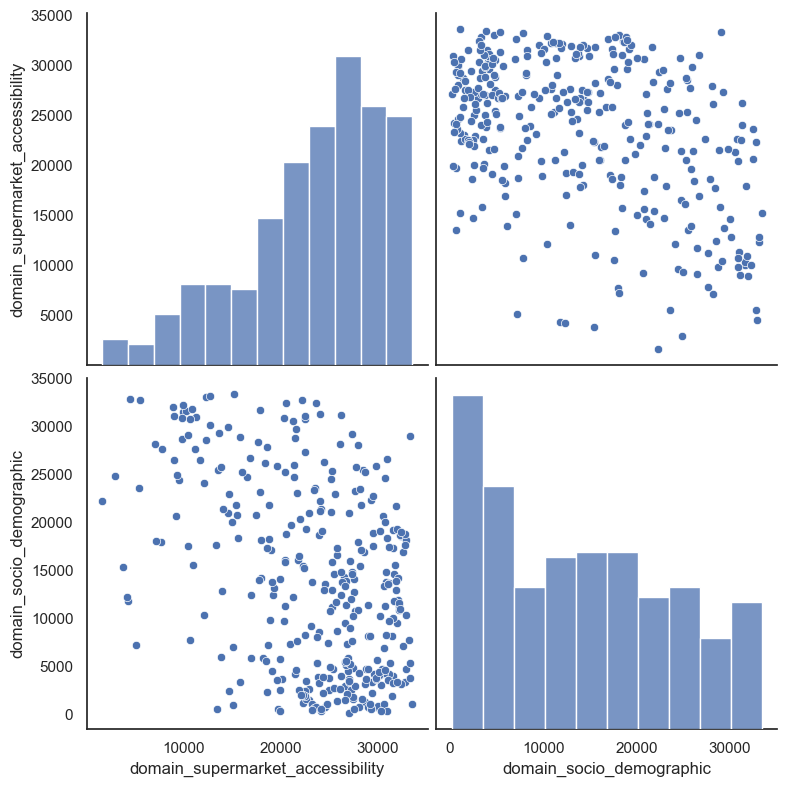

In [14]:
# plot pairplot, adjust height so domain names fit on axis
sns.pairplot(sheffield_PPFI[['domain_supermarket_accessibility',
       'domain_socio_demographic']], height=4)

#### __To support our visualisations we are going to perform Spearman's Rank Correlation. I have chosen this method because the method does not assume linearity between variables, making it suitable for detecting monotonic relationship. The model also performs well with outliers in data.__

In [15]:
# Calculate Spearman's rank correlation
ppfi_domains_corr =sheffield_PPFI[['domain_supermarket_accessibility', 'domain_socio_demographic']].corr(method = 'spearman')
ppfi_domains_corr

,domain_supermarket_accessibility,domain_socio_demographic
domain_supermarket_accessibility,1.000000,-0.349126
domain_socio_demographic,-0.349126,1.000000


#### __Describing the outcome:__

The Spearman rank correlation coefficient ranges from -1 to 1:

A value of 1 indicates a perfect positive rank correlation, meaning that as one variable increases, the other variable also increases in rank.
A value of -1 indicates a perfect negative rank correlation, meaning that as one variable increases in rank, the other variable decreases in rank.
A value of 0 indicates no rank correlation between the variables.

In this case, you the model has a correlation coefficient of -0.349126, which is negative but not very close to -1. This negative correlation suggests that as the rank of "domain_supermarket_accessibility" increases (i.e., it becomes more accessible), the rank of "domain_socio_demographic" tends to decrease. Conversely, as the rank of "domain_socio_demographic" increases (i.e., certain socio-demographic factors increase), the rank of "domain_supermarket_accessibility" tends to decrease.

However, the correlation coefficient is relatively small (-0.349126), indicating a weak negative correlation between the two domains. It's important to note that correlation does not imply causation, so further analysis would be needed to determine the underlying relationship between these domains.

#### __Supporting the outcome with a Visualisation:__

Labels: Index(['supermarket accessibility', 'socio demographic'], dtype='object') Index(['supermarket accessibility', 'socio demographic'], dtype='object')
Labels with capital letters: ['Supermarket accessibility', 'Socio demographic'] ['Supermarket accessibility', 'Socio demographic']


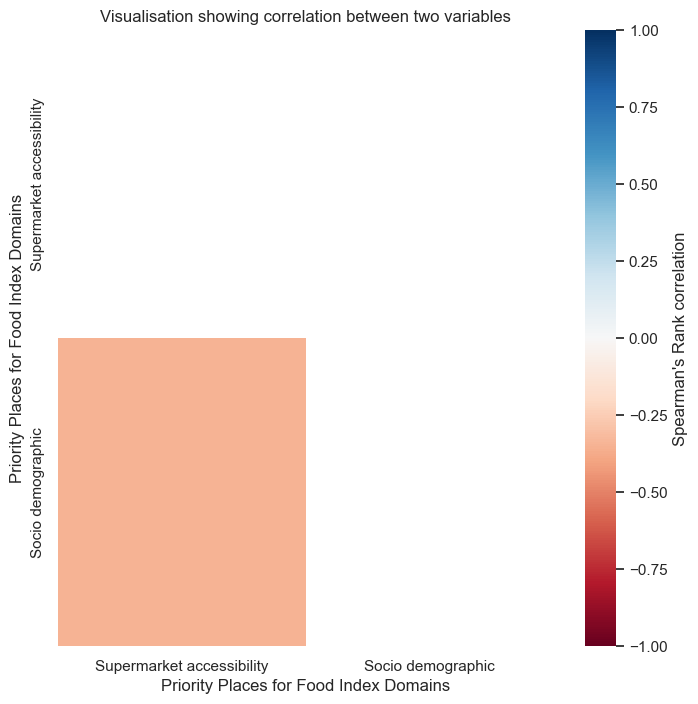

In [16]:
# define plot size
fig,ax = plt.subplots(figsize=(8,8))

# define mask to apply to upper right hand corner of the plot
data_to_mask = np.triu(np.ones_like(ppfi_domains_corr))

# define axis tick labels
# get the index and the columns, replace the underscores with spaces and remove 'domain ' from the name
x_axis_labels = ppfi_domains_corr.columns.str.replace('_',' ').str.replace('domain ','')
y_axis_labels = ppfi_domains_corr.index.str.replace('_',' ').str.replace('domain ','')

# Have a look at what the tick labels look like
print('Labels:',x_axis_labels ,y_axis_labels)

# If we want to capitalize each tick label
# for each element in the list of x_axis_labels, capitalize it
x_axis_labels = [element.capitalize() for element in x_axis_labels]
y_axis_labels = [element.capitalize() for element in y_axis_labels]

# look at the new labels
print('Labels with capital letters:',x_axis_labels ,y_axis_labels)


# plot a heatmap of the correlation dataframe
sns.heatmap(ppfi_domains_corr, 
            # annotate so spearman's rank correlation values are displayed on the squares
            annot=True, 
            # define colourmap
            cmap='RdBu', 
            # define value of minimum colour on cbar
            vmin=-1, 
            # define value of maximum colour on cbar
            vmax=1,
            # add the mask
            mask=data_to_mask, 
            # use the custom tick labels
            xticklabels=x_axis_labels, 
            yticklabels=y_axis_labels,
            # add a label to the cbar
            cbar_kws={'label': "Spearman's Rank correlation"},
            # plot on the axis we defined
            ax=ax)

# Set axis labels
ax.set(xlabel="Priority Places for Food Index Domains", 
       ylabel="Priority Places for Food Index Domains",
      title ='Visualisation showing correlation between two variables' );




#### __Now if we exclude the 'mask=data_to_mask' from the code above we will find the folloing result. It shows the complete result without masking the negative outcome.__ 

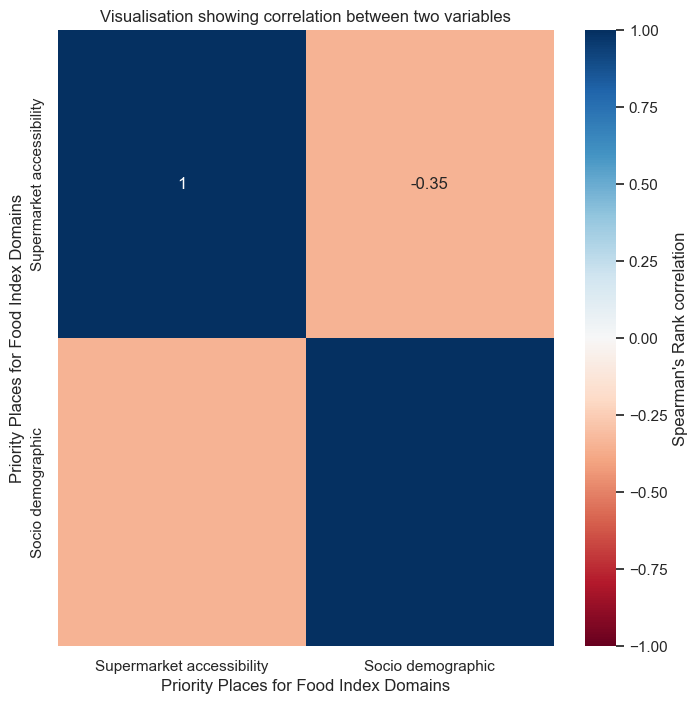

In [17]:
# define plot size
fig,ax = plt.subplots(figsize=(8,8))

# plot a heatmap of the correlation dataframe
sns.heatmap(ppfi_domains_corr, 
            # annotate so spearman's rank correlation values are displayed on the squares
            annot=True, 
            # define colourmap
            cmap='RdBu', 
            # define value of minimum colour on cbar
            vmin=-1, 
            # define value of maximum colour on cbar
            vmax=1,
            # comment out the mask
            #mask=data_to_mask, 
            # use the custom tick labels
            xticklabels=x_axis_labels, 
            yticklabels=y_axis_labels,
            # add a label to the cbar
            cbar_kws={'label': "Spearman's Rank correlation"},
            # plot on the axis we defined
            ax=ax)

# Set axis labels
ax.set(xlabel="Priority Places for Food Index Domains", 
       ylabel="Priority Places for Food Index Domains",
      title ='Visualisation showing correlation between two variables' );


## __Acknowledgement:__

##### 1. Purdam, K., Garratt, E. A., & Esmail, A. 2016. Hungry? Food Insecurity, Social Stigma and Embarrassment in the UK. Sociology, 50(6), 1072-1088. https://doi.org/10.1177/0038038515594092

##### 2. Priority Places for Food Index Version 2, Consumer Data Research Centre. 2024. Available from: https://data.cdrc.ac.uk/dataset/priority-places-food-index-version-233

##### 3. Lower layer Super Output Areas (December 2021) Boundaries EW BFE V9. 2023. Available from: https://geoportal.statistics.gov.uk/datasets/ons::lower-layer-super-output-areas-december-2021-boundaries-ew-bfe-v9/about

##### 4. Priority Places for Food Index Version 2. 2024. Available from: https://data.cdrc.ac.uk/dataset/priority-places-food-index-version-2